In [3]:
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(Seurat))
suppressPackageStartupMessages(library(anndata))
library(FNN)

library(ggplot2)
library(pheatmap)
library(RColorBrewer)
library(GenomicRanges)
source("/projects/ps-renlab2/y2xie/scripts/basics.R")
source("/projects/ps-renlab2/y2xie/scripts/DPT_help.R")
source("/projects/ps-renlab2/y2xie/scripts/DPT/BICAN_help.R")
source("/projects/ps-renlab2/y2xie/scripts/spatial/spatial_help.R")
### this is just to resize jupyter notebook plot size
library(repr)

Warning message:
“package ‘SeuratObject’ was built under R version 4.4.3”
Warning message:
“package ‘sp’ was built under R version 4.4.2”
Warning message:
“package ‘pheatmap’ was built under R version 4.4.3”
Warning message:
“package ‘GenomicRanges’ was built under R version 4.4.2”
Loading required package: stats4

Loading required package: BiocGenerics

Warning message:
“package ‘BiocGenerics’ was built under R version 4.4.2”

Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, m

### Read metadata

In [5]:
lmeta <- read.csv("../04.clustering/02.RNA/03.l3_clustering/MiniAtlas_RNA_merged_dual_filt_clean_corrected_250722_metadata.txt", 
                  sep = "\t", row.names = 1)

In [6]:
### Add brain region color
cols <- read.csv("/projects//ps-renlab2/y2xie/projects/BICAN/ref/yel_Science2023_supp/brain_dissection_anno.xls", sep = "\t")
col1 <- cols %>% dplyr::select(Brain.structure.name, Brain.structure.color) %>% distinct %>% dplyr::select(Brain.structure.color) %>% unlist
names(col1) <- cols %>% dplyr::select(Brain.structure.name, Brain.structure.color) %>% distinct %>% dplyr::select(Brain.structure.name) %>% unlist

col2 <- cols %>% dplyr::select(Brain.region, Brain.region.color) %>% distinct %>% dplyr::select(Brain.region.color) %>% unlist
names(col2) <- cols %>% dplyr::select(Brain.region, Brain.region.color) %>% distinct %>% dplyr::select(Brain.region) %>% unlist

In [7]:
cols <- read.csv("../../ref/yel_Science2023_supp/subclass_celltype_match.csv")
tmp <- distinct(cols[,c("Cell.class", "Cell.class.color")])
ccol1 <- tmp$Cell.class.color
names(ccol1) <- gsub("GLUT", "Glut", tmp$Cell.class)

tmp <- read.csv("../04.clustering/subclass_corrected.color.csv", row.names = 1)
ccol2 <- tmp$color
names(ccol2) <- tmp$MiniAtlas

In [8]:
bcol <- read.csv("../Figure/superterm.color", row.names = 1, sep = "\t")
ccol3 <- bcol$bcol
names(ccol3) <- rownames(bcol)

dcol <- c("#8ecae6", "#00acdf", "#006699")
names(dcol) <- unique(lmeta$donor)

tcol <- c("#2EA7E0", "#956134")
names(tcol) <- c("H3K27ac", "H3K27me3")

In [9]:
corder <- read.table("../04.clustering/order.subclass.250601", sep = "\t") %>% dplyr::select(V1) %>% unlist %>% as.character
corder2 <- read.table("../04.clustering/order.cluster.250601", sep = "\t") %>% dplyr::select(V1) %>% unlist %>% as.character

In [10]:
glut <- lmeta %>% filter(structure == "Cortex", class == "Glut") %>% select(subclass_corrected) %>% unique %>%
unlist %>% as.character
gaba <- lmeta %>% filter(structure == "Cortex", class == "GABA") %>% select(subclass_corrected) %>% unique %>%
unlist %>% as.character
nonn <- lmeta %>% filter(structure == "Cortex", class == "NonN") %>% select(subclass_corrected) %>% unique %>%
unlist %>% as.character

In [32]:
### these are selected by Eric based on MorphoGAM
badfov <- c("UCI4723Q04PPHC", "UCI4723Q06Ig", "UCI2424Q06Ig") 
goodfov <- c('UCI2424Q02A38',
'UWA7648Q02A38',
'UCI5224Q04PPHC',
'UWA7648Q04PPHC',
'UCI2424Q04PPHC',
'UCI5224Q06Ig',
'UWA7648Q06Ig',
'UCI2424Q02PSC1',
'UCI4723Q02PSC1',
'UCI5224Q02PSC1',
'UCI4723Q06PSC2',
'UWA7648Q06PSC2',
'UCI2424Q06PSC2',
'UCI5224Q06PSC2'
)
goodfov <- setdiff(goodfov, badfov)

## Read MERFISH data from CfE / Ecker lab

In [76]:
library(anndata)
adata = read_h5ad("quan_cortex_annotated.11.20.2025.h5ad")

### is this MERFISH only or with PT?
grep("-1", adata$obs_names, value = T) %>% length

character(0)

[1] 0

In [99]:
mtx <- adata$layers['counts']
tmeta <- adata$obs
tmp <- CreateSeuratObject(counts = t(mtx), meta.data = tmeta)

### Filter: nCount + size as Fang 2022
qcell <- tmp@meta.data %>% filter(nCount_RNA >= 0.1*volume, nCount_RNA >= 100) %>% rownames
tmp <- subset(tmp, cells = qcell)

Warning message:
“Data is of class matrix. Coercing to dgCMatrix.”


Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“Default search for "data" layer in "RNA" assay yielded no results; utilizing "counts" layer instead.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



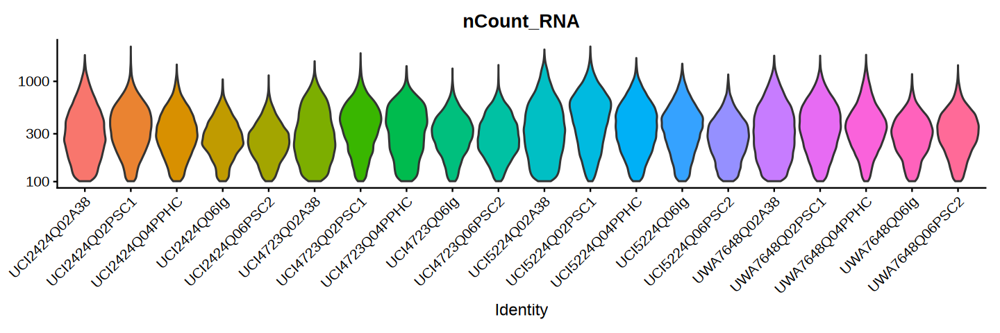

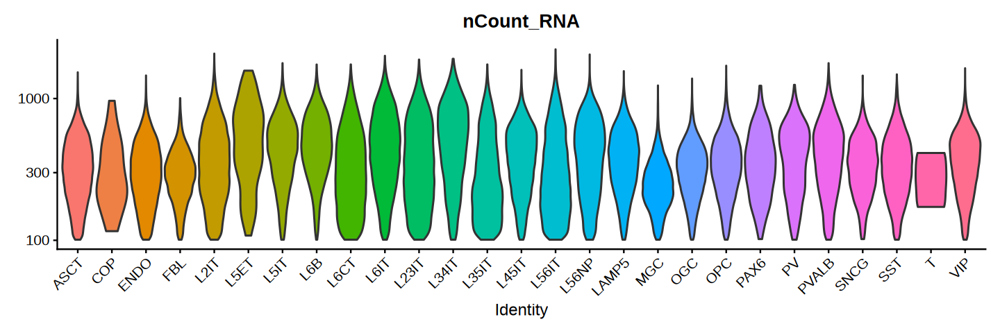

In [107]:
options(repr.plot.width = 12, repr.plot.height = 4)
Idents(tmp) <- "region"
VlnPlot(tmp, "nCount_RNA", pt.size = 0, log = T) + NoLegend()

Idents(tmp) <- "_CELLTYPE_HARM"
VlnPlot(tmp, "nCount_RNA", pt.size = 0, log = T) + NoLegend()

In [106]:
saveRDS(tmp, "quan_cortex_annotated.11.20.2025.filt_for_int.rds")

## CCA integration with scRNA-seq

In [84]:
border <- read.table("../12.heterogenity/Miniatlas_AP-axis_v1.txt", sep = '\t', row.names = 1, header = T)
qregion <- c("A38", "PSC", "PPHC", "Ig")
distinct(border[grep(paste0(qregion, collapse = "|"), border$tregion),c("Miniatlas", "tregion")])
qregion <- c("A38", "A19", "TH-TL", "Ig")

,Miniatlas,tregion
,<chr>,<chr>
8,A38,A38
57,Ig,Ig
60,Ig,"Ig (r, c)"
75,TH-TL,"PPHC (TH, TL)"
96,A19,PSC
99,A19,"PSC (V3, V3A, V3B, V4, VP)"
101,A19,"PSC (V3, V3A, V3B, V4, VP, VP6)"


In [93]:
ref <- qs::qread("../04.clustering/02.RNA/03.l3_clustering/MiniAtlas_RNA_merged_dual_filt_clean_corrected_250529.qs")
ref$subclass_corrected <- lmeta[colnames(ref),]$subclass_corrected

### filter for matched regions
ref <- subset(ref, subset = subclass_corrected != "MSN" & region %in% qregion)

validc <- ref@meta.data %>% filter(region %in% qregion, ) %>%
select(subclass_corrected) %>% table %>% as.data.frame %>% filter(Freq >= 50) %>% select(subclass_corrected) %>%
unlist %>% as.character
length(validc)

In [124]:
options(future.globals.maxSize = 13e+11) ### 128G
obj <- merge(ref, tmp)
obj <- SCTransform(obj)
obj <- NormalizeData(obj)
obj <- FindVariableFeatures(obj)
obj <- ScaleData(obj, verbose = FALSE)

obj <- RunPCA(obj, npcs = 50, verbose = F)
obj <- IntegrateLayers(
    object = obj,
    method = CCAIntegration,
    normalization.method = "SCT",
    new.reduction = "integrated.cca",
    verbose = F
)

gc()

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,11449722,611.5,23308954,1244.9,23308954,1244.9
Vcells,5960434810,45474.6,37308349563,284640.2,64175567531,489620.8


In [129]:
significant_pc_test(obj@reductions$integrated.dr@cell.embeddings, min_pc = 15)

[1] "Downsample PC matrix to 25000 cells to calculate significant PC components"


[1] 50

In [130]:
obj <- RunUMAP(obj, dims = 1:35, reduction = "integrated.cca")
obj <- RunUMAP(obj, dims = 1:50, reduction = "integrated.cca", reduction.name = "umap50")

16:36:42 UMAP embedding parameters a = 0.9922 b = 1.112

16:36:42 Read 506153 rows and found 50 numeric columns

16:36:42 Using Annoy for neighbor search, n_neighbors = 30

16:36:42 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:37:47 Writing NN index file to temp file /tmp/RtmpSyDhUq/file36f533a4c98e2

16:37:47 Searching Annoy index using 1 thread, search_k = 3000

16:41:47 Annoy recall = 100%

16:41:49 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:42:04 Initializing from normalized Laplacian + noise (using RSpectra)

16:42:49 Commencing optimization for 200 epochs, with 25065868 positive edges

16:42:49 Using rng type: pcg

16:46:18 Optimization finished



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning messag

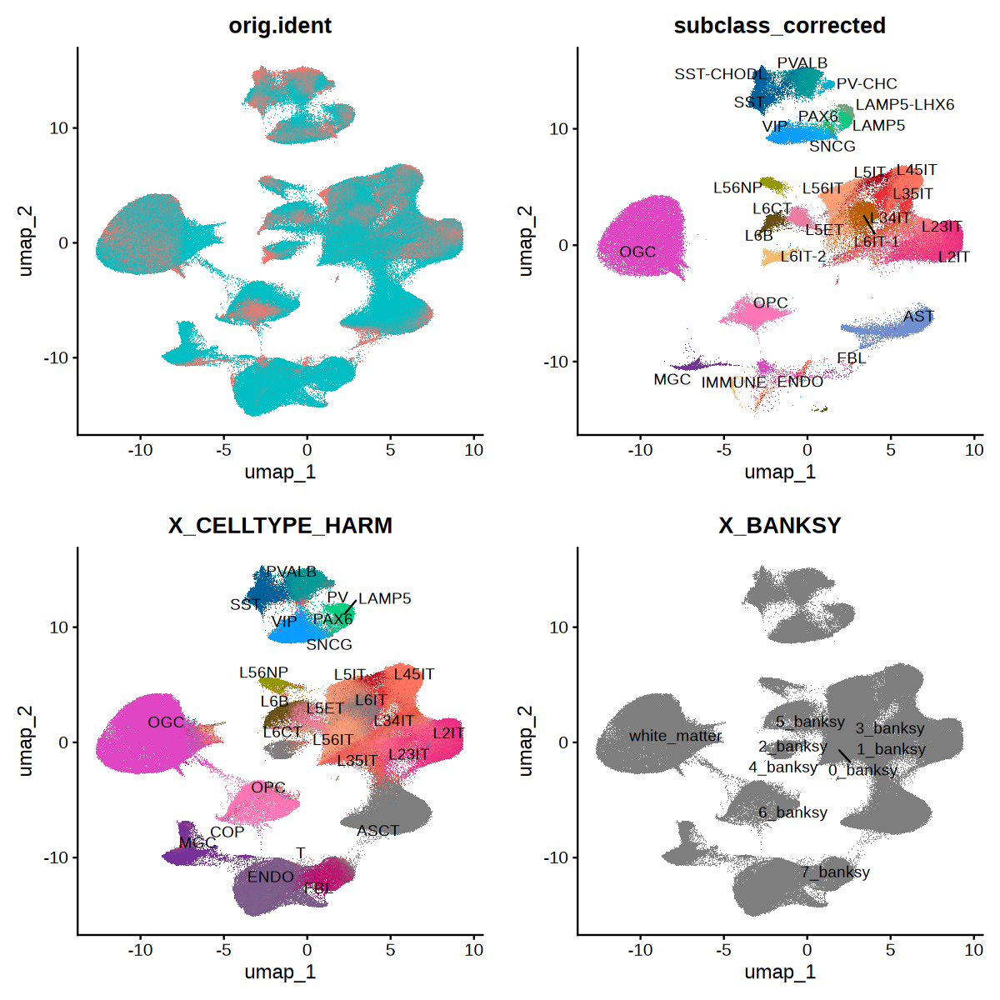

In [132]:
t0 <- DimPlot(obj, group.by = "orig.ident", label = F, repel = T, reduction = "umap") + NoLegend()
t1 <- DimPlot(obj, group.by = "subclass_corrected", label = T, repel = T, cols = ccol2, 
              cells = rownames(obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", ]), reduction = "umap") + NoLegend()
t2 <- DimPlot(obj, group.by = "X_CELLTYPE_HARM", label = T, repel = T, cols = ccol2,
              cells = rownames(obj@meta.data[obj$orig.ident == "MERFISH", ]), reduction = "umap") + NoLegend()
t3 <- DimPlot(obj, group.by = "X_BANKSY", label = T, repel = T, cols = ccol2,
              cells = rownames(obj@meta.data[obj$orig.ident == "MERFISH", ]), reduction = "umap") + NoLegend()

options(repr.plot.width = 10, repr.plot.height = 10)
cowplot::plot_grid(t0, t1, t2, t3, ncol = 2)

In [133]:
obj <- FindNeighbors(obj, dims = 1:50, reduction = "integrated.cca")
obj <- FindClusters(obj, resolution = 1)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 506153
Number of edges: 18155339

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9141
Number of communities: 45
Elapsed time: 509 seconds


11 singletons identified. 34 final clusters.



In [134]:
saveRDS(obj, "quan_cortex_annotated.11.20.2025_MiniAtlas_integration.rds")

## Re-annotate MERFISH subclass based on shared embeddings 

In [45]:
### Region by region
rcell <- obj@meta.data %>% filter(orig.ident == "MERFISH") %>% rownames
rmatch <- obj@meta.data[rcell, c("br_region", "region")] %>% distinct
rmatch[rmatch$br_region == 'PPHC',]$br_region <- "TH-TL"
rmatch[rmatch$br_region %in% c('PSC.01', 'PSC.02'),]$br_region <- "A19"
rmatch

,br_region,region
,<chr>,<chr>
3173026700021100669,A38,UCI4723Q02A38
3173026500022100042,A38,UCI2424Q02A38
3173027100026100068,A38,UWA7648Q02A38
3173026100000100103,A38,UCI5224Q02A38
3377584600010100054,TH-TL,UCI4723Q04PPHC
3377584000003100080,TH-TL,UCI5224Q04PPHC
3377584900000100007,TH-TL,UWA7648Q04PPHC
3377584300006100084,TH-TL,UCI2424Q04PPHC
3442817800017100857,Ig,UCI4723Q06Ig


In [119]:
### Use DPT data from matched regions as reference
pred <- list()
for (f in unique(rmatch$region)){
    qregion <- rmatch %>% filter(region == f) %>% select(br_region) %>% unlist %>% as.character
    qmeta <- obj@meta.data %>% filter(orig.ident == "MERFISH", region == f)
    qcell <- rownames(qmeta)
    rmeta <- obj@meta.data %>% filter(orig.ident == "Droplet Paired-Tag", region %in% qregion)
    rcell <- rownames(rmeta)
    qemb <- obj@reductions$integrated.cca@cell.embeddings[qcell, ]
    remb <- obj@reductions$integrated.cca@cell.embeddings[rcell, ]
    pred[[f]] <- run_merfish_classification(remb, qemb, rmeta, ref_label_col = "subclass_corrected", k = 30)
}

pred <- do.call(rbind, pred)

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...



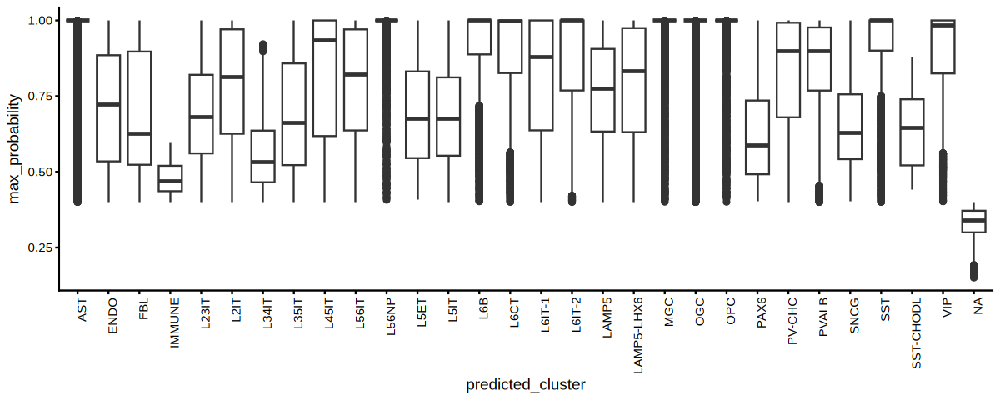

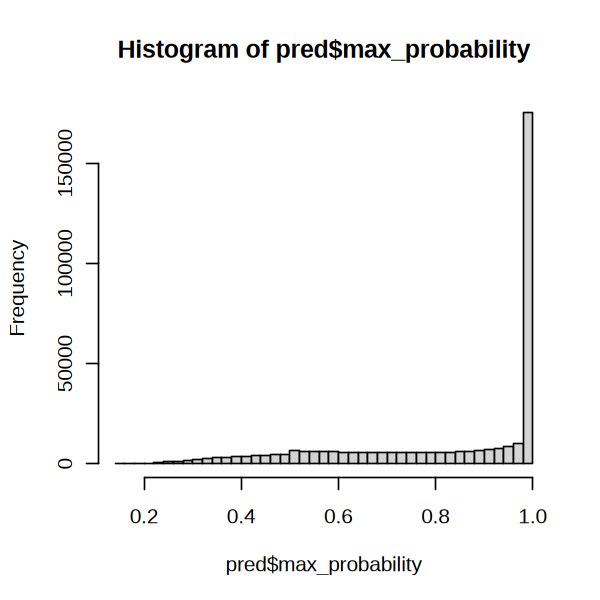

In [125]:
options(repr.plot.width = 10, repr.plot.height = 4)
pred %>%
ggplot(aes(x=predicted_cluster, y = max_probability)) + 
geom_boxplot() + 
theme_classic() + 
theme(axis.text.x = element_text(angle = 90, hjust = 1)) + 
NoLegend() 

options(repr.plot.width = 5, repr.plot.height = 5)
hist(pred$max_probability, breaks = 50)

In [134]:
pred <- pred %>% mutate(final_cluster = ifelse(max_probability >= 0.5, predicted_cluster, "low quality")) 
obj$X_CELLTYPE_CCA <- NA
obj@meta.data[pred$cell_id,]$X_CELLTYPE_CCA <- pred$final_cluster

## Prediction of cluster label too

In [148]:
### we need to perform subclass-by-subclass prediction
pred <- list()
for (f in unique(rmatch$region)){
    qregion <- rmatch %>% filter(region == f) %>% select(br_region) %>% unlist %>% as.character
    qmeta <- obj@meta.data %>% filter(orig.ident == "MERFISH", region == f, X_CELLTYPE_CCA != "low quality")
    rmeta <- obj@meta.data %>% filter(orig.ident == "Droplet Paired-Tag", region %in% qregion)
    for (ct in unique(qmeta$X_CELLTYPE_CCA)){
        qcell <- qmeta %>% filter(X_CELLTYPE_CCA == ct) %>% rownames
        ### allow more flexiable matching in reference
        rcell <- rmeta %>% filter(subclass_corrected %in% smatch[smatch$X_CELLTYPE_CCA == ct,]$subclass_corrected) %>% rownames  
        if (length(qcell) >= 5 & length(rcell) >= 5){
            qemb <- obj@reductions$integrated.cca@cell.embeddings[qcell, ]
            remb <- obj@reductions$integrated.cca@cell.embeddings[rcell, ]
            pred[[paste0(f, ":", ct)]] <- run_merfish_classification(remb, qemb, rmeta[rcell,], ref_label_col = "cluster_manual_name", k = 15)
         }
     }
}

pred <- do.call(rbind, pred)

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classifier...

Running neighborhood-based classif

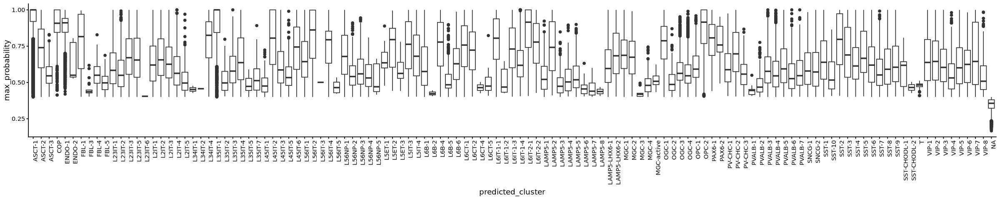

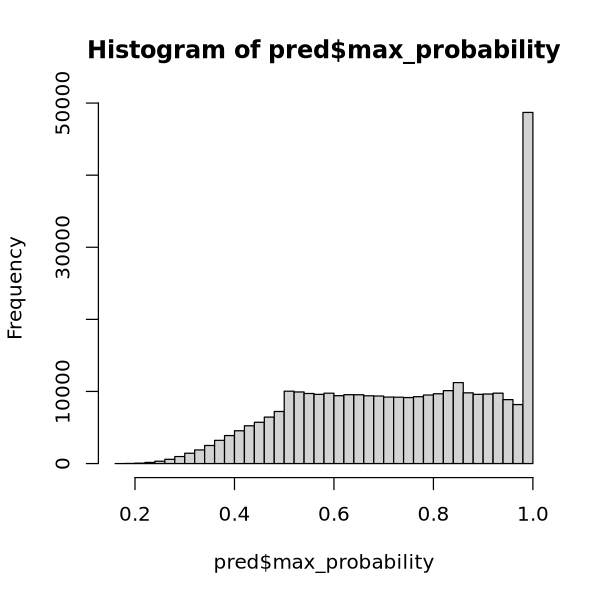

In [150]:
options(repr.plot.width = 20, repr.plot.height = 4)
pred %>%
ggplot(aes(x = predicted_cluster, y = max_probability)) + 
geom_boxplot() + 
theme_classic() + 
theme(axis.text.x = element_text(angle = 90, hjust = 1)) + 
NoLegend() 

options(repr.plot.width = 5, repr.plot.height = 5)
hist(pred$max_probability, breaks = 50)

In [151]:
pred <- pred %>% mutate(final_cluster = ifelse((max_probability >= 0.5 & !is.na(max_probability)), predicted_cluster, "low quality")) 
obj$X_SUBTYPE_CCA <- NA
obj@meta.data[pred$cell_id,]$X_SUBTYPE_CCA <- pred$final_cluster

## Check integration results

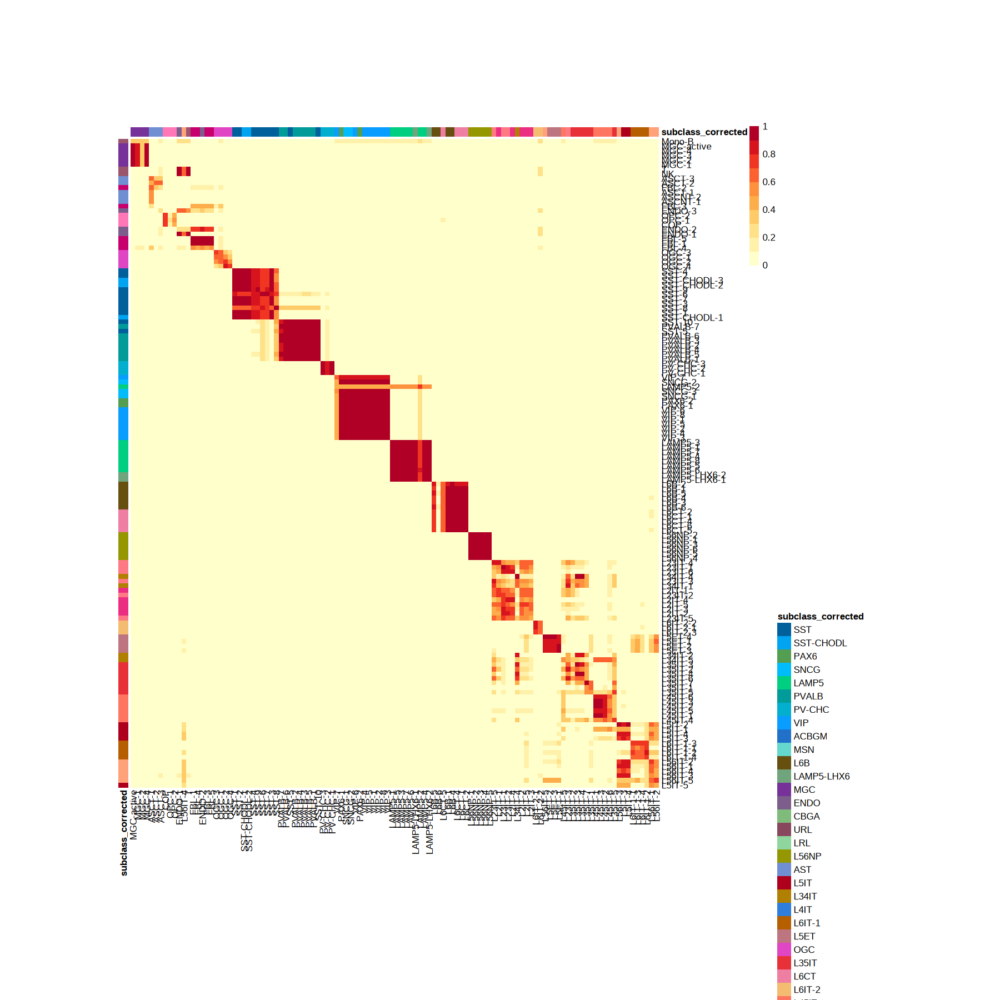

In [33]:
t1 <- obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", c("seurat_clusters", "cluster_manual_name")]
t2 <- obj@meta.data[obj$orig.ident == "MERFISH", c("seurat_clusters", "X_SUBTYPE_CCA")] %>%
filter(X_SUBTYPE_CCA != "low quality")
ovlp_score <- cal_ovlpScore(t1, t2)

rmat <- ovlp_score %>%
reshape2::dcast(anno1 ~ anno2) %>%
tibble::column_to_rownames("anno1") %>% t

ctk <- which(apply(rmat, 1, max) > 0.01)
rmat <- rmat[ctk, intersect(corder2, colnames(rmat))]

max_indices <- max.col(rmat)
permutation_vector <- order(max_indices)
smat <- rmat[permutation_vector, ] %>% t

canno <- obj@meta.data[obj$orig.ident == "Droplet Paired-Tag",c("cluster_manual_name", "subclass_corrected")] %>% 
distinct %>% tibble::remove_rownames() %>%
tibble::column_to_rownames("cluster_manual_name")

rannocolor <- list(subclass_corrected = ccol2)

options(repr.plot.width = 15, repr.plot.height = 15)
p1 <- smat %>% 
pheatmap(cluster_rows = F, cluster_cols = F, border_color = NA, angle_col = 90, 
         cellheight = 5, cellwidth = 5, annotation_colors = rannocolor, 
         annotation_row = canno, annotation_col = canno,
         color = colorRampPalette(brewer.pal(n = 8, name = "YlOrRd"))(10))

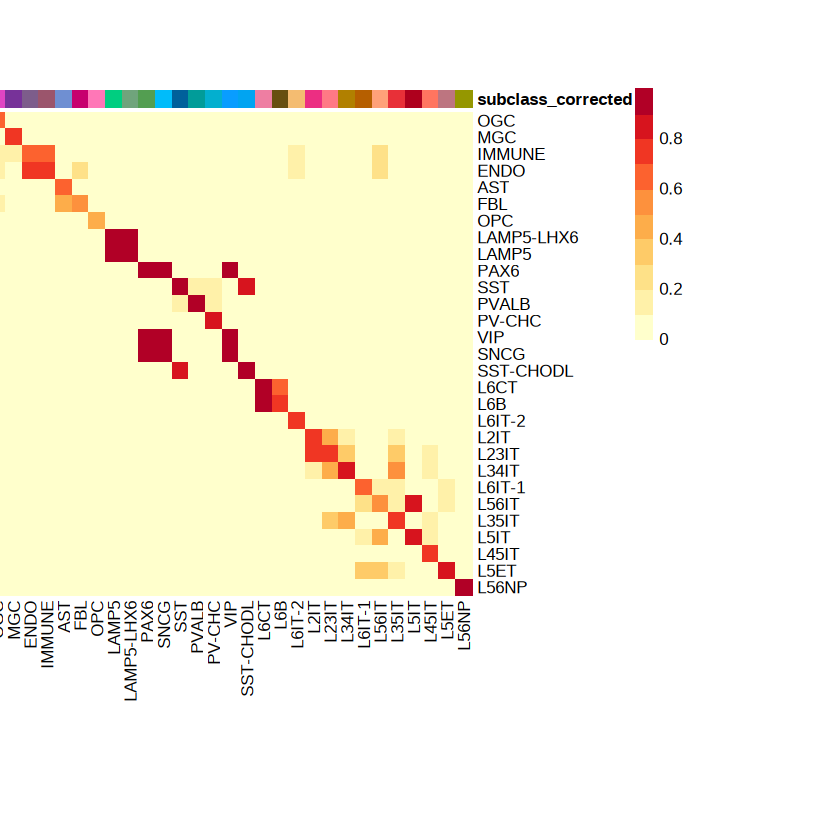

In [38]:
t1 <- obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", c("seurat_clusters", "subclass_corrected")]
t2 <- obj@meta.data[obj$orig.ident == "MERFISH", c("seurat_clusters", "X_CELLTYPE_CCA")] %>%
filter(X_CELLTYPE_CCA != "low quality")
ovlp_score <- cal_ovlpScore(t1, t2)

rmat <- ovlp_score %>%
reshape2::dcast(anno1 ~ anno2) %>%
tibble::column_to_rownames("anno1") %>% t

ctk <- which(apply(rmat, 1, max) > 0.01)
rmat <- rmat[ctk, intersect(corder, colnames(rmat))]

max_indices <- max.col(rmat)
permutation_vector <- order(max_indices)
smat <- rmat[permutation_vector, ] %>% t

canno <- obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", "subclass_corrected", drop = F] %>% distinct
rownames(canno) <- canno[,1]

rannocolor <- list(subclass_corrected = ccol2)
options(repr.plot.width = 7, repr.plot.height = 7)
p1 <- smat %>% 
pheatmap(cluster_rows = F, cluster_cols = F, border_color = NA, angle_col = 90, 
         cellheight = 10, cellwidth = 10, annotation_colors = rannocolor, 
         annotation_row = canno, annotation_col = canno,
         color = colorRampPalette(brewer.pal(n = 8, name = "YlOrRd"))(10))

In [137]:
### Get subclass matching
### tolerate some mismatch for more reliable imputation 
smatch <- do.call(rbind, apply(smat, MARGIN = 2, function(x) as.data.frame(rownames(smat)[which(x > 0.4)]))) %>%
setNames("subclass_corrected") %>%
tibble::rownames_to_column("X_CELLTYPE_CCA") %>%
mutate(X_CELLTYPE_CCA = gsub("([^\\.]+)\\.([^\\.]+)", "\\1", X_CELLTYPE_CCA)) %>% distinct

In [49]:
obj$nregion <- NA
obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", ]$nregion <- obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", ]$region
obj@meta.data[obj$orig.ident == "MERFISH", ]$nregion <- obj@meta.data[obj$orig.ident == "MERFISH", ]$br_region
obj@meta.data <- obj@meta.data %>% 
mutate(nregion = ifelse(nregion == "PPHC", "TH-TL", nregion)) %>% 
mutate(nregion = ifelse(nregion %in% c("PSC.01", "PSC.02"), "A19", nregion)) 

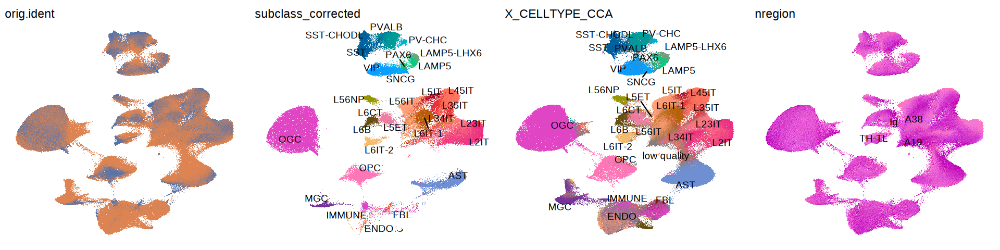

In [51]:
t0 <- DimPlot(obj, group.by = "orig.ident", label = F, repel = T, reduction = "umap", cols = c("#4C72B0", "#DD8452", "#55A868")) + theme_void() + NoLegend()
t1 <- DimPlot(obj, group.by = "subclass_corrected", label = T, repel = T, cols = ccol2, 
              cells = rownames(obj@meta.data[obj$orig.ident == "Droplet Paired-Tag", ]), reduction = "umap") + theme_void() + NoLegend()
t2 <- DimPlot(obj, group.by = "X_CELLTYPE_CCA", label = T, repel = T, cols = ccol2,
              cells = rownames(obj@meta.data[obj$orig.ident == "MERFISH", ]), reduction = "umap") + theme_void() + NoLegend()
t3 <- DimPlot(obj, group.by = "nregion", label = T, repel = T, cols = col2, reduction = "umap") + theme_void() + NoLegend() 

options(repr.plot.width = 16, repr.plot.height = 4)
cowplot::plot_grid(t0, t1, t2, t3, ncol = 4)

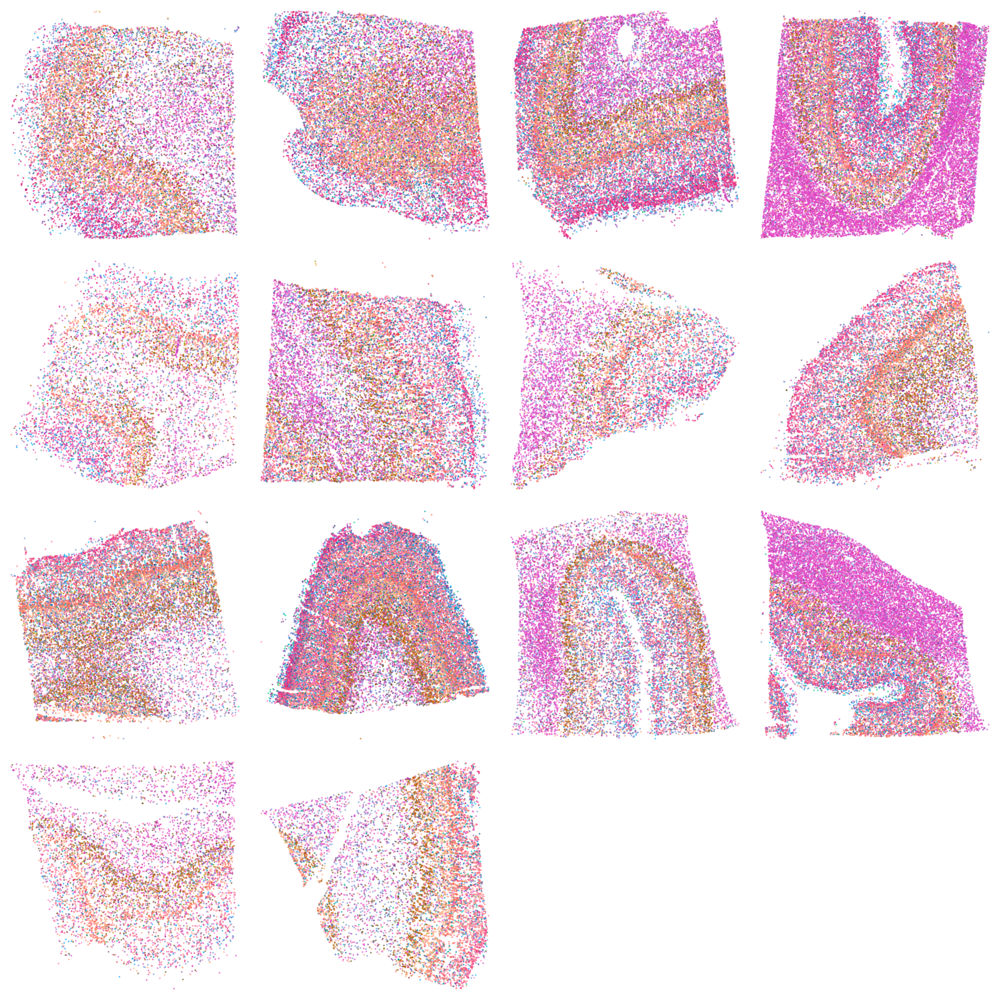

In [39]:
### visualize cell types prediction on slides
plist2 <- list()
for (f in goodfov){
    plist2[[f]] <- obj@meta.data %>%
    filter(orig.ident == "MERFISH", region == f, X_CELLTYPE_CCA != "low quality") %>%
    ggplot(aes(x = center_x, y = center_y, color = X_CELLTYPE_CCA)) + 
    geom_point(size = 0.3, alpha = 0.5) + 
    scale_color_manual(values = ccol2) + 
    theme_void() + NoLegend()
}

options(repr.plot.width = 16, repr.plot.height = 16)
cowplot::plot_grid(plotlist = plist2, ncol = 4)

## Classify laminar layers

In [71]:
mmg <- readRDS("quan_cortex_annotated.11.20.2025.filt_for_int.rds")
mmg2 <- subset(mmg, subset = X_CELLTYPE_CCA %in% glut) ### use all glut as anchors
for (f in as.character(unique(mmg2$region))){
    mmg2 <- BuildNicheAssay(mmg2, fov = f, group.by = "X_CELLTYPE_CCA", cluster.name = paste0("niches_", f), 
                            neighbors.k = 30, niches.k = 5) ### this is the best number tested
}
mmg2

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and scaling data matrix

Computing nearest neighbor graph

Warning message:
“Different cells and/or features from existing assay niche”
Centering and

An object of class Seurat 
972 features across 213780 samples within 2 assays 
Active assay: niche (13 features, 0 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 3 dimensional reductions calculated: ucsd_pca, ucsd_harmony, ucsd_harmony_umap
 20 spatial fields of view present: UCI4723Q02A38 UCI2424Q02A38 UWA7648Q02A38 UCI5224Q02A38 UCI4723Q04PPHC UCI5224Q04PPHC UWA7648Q04PPHC UCI2424Q04PPHC UCI4723Q06Ig UCI5224Q06Ig UCI2424Q06Ig UWA7648Q06Ig UCI2424Q02PSC1 UCI4723Q02PSC1 UCI5224Q02PSC1 UWA7648Q02PSC1 UCI4723Q06PSC2 UWA7648Q06PSC2 UCI2424Q06PSC2 UCI5224Q06PSC2

In [90]:
### Determine layers for all fov. Do manual check
clasdf <- data.frame(region = unique(mmg2$region),
           "1" = c("L23", "White_matter", "L4", "L2", "L2", "L4", "White_matter", "L6", 
                   "L5", "L23", "L6", "L5", "L2", "L6", "L5", "White_matter",
                   "L6", "White_matter", "L4", "L5"),
           "2" = c("L4", "L5", "L5", "L5", "L5", "L4", "L4", "L5", 
                   "L6", "L4", "L5", "L6", "L5", "L4", "L4", "L6",
                   "White_matter", "L23", "White_matter", "L23"),
           "3" = c("L4", "L23", "L5", "L6", "L23", "L23", "L23", "White_matter", 
                   "L23", "L6", "L23", "White_matter", "L6", "L23", "L23", "L4",
                   "L4", "L4", "L6", "L6"),
           "4" = c("L23", "L6", "White_matter", "L23", "White_matter", "White_matter", "L6", "L23", 
                   "L2", "White_matter", "L4", "L23", "L4", "L5", "L6", "L5",
                   "L23", "L6", "L5", "L4"),
           "5" = c("L23", "L4", "L23", "White_matter", "L6", "L56", "L5", "L4", 
                   "L4", "L5", "White_matter", "L4", "L23", "L2", "White_matter", "L23",
                   "L5", "L5", "L23", "White_matter"))

In [99]:
mmg2$layer <- NA
for (f in unique(mmg2$region)){
    tmp <- clasdf %>% filter(region == f)
    qcell <- mmg2@meta.data[,c("region", paste0("niches_", f))] %>% 
    setNames(c("region", "niches")) %>% 
    filter(region == f, !is.na(niches)) %>% rownames
    
    mmg2@meta.data[qcell, ]$layer <- tmp[,paste0("X", mmg2@meta.data[qcell, paste0("niches_", f)])] %>% unlist %>% as.character
}

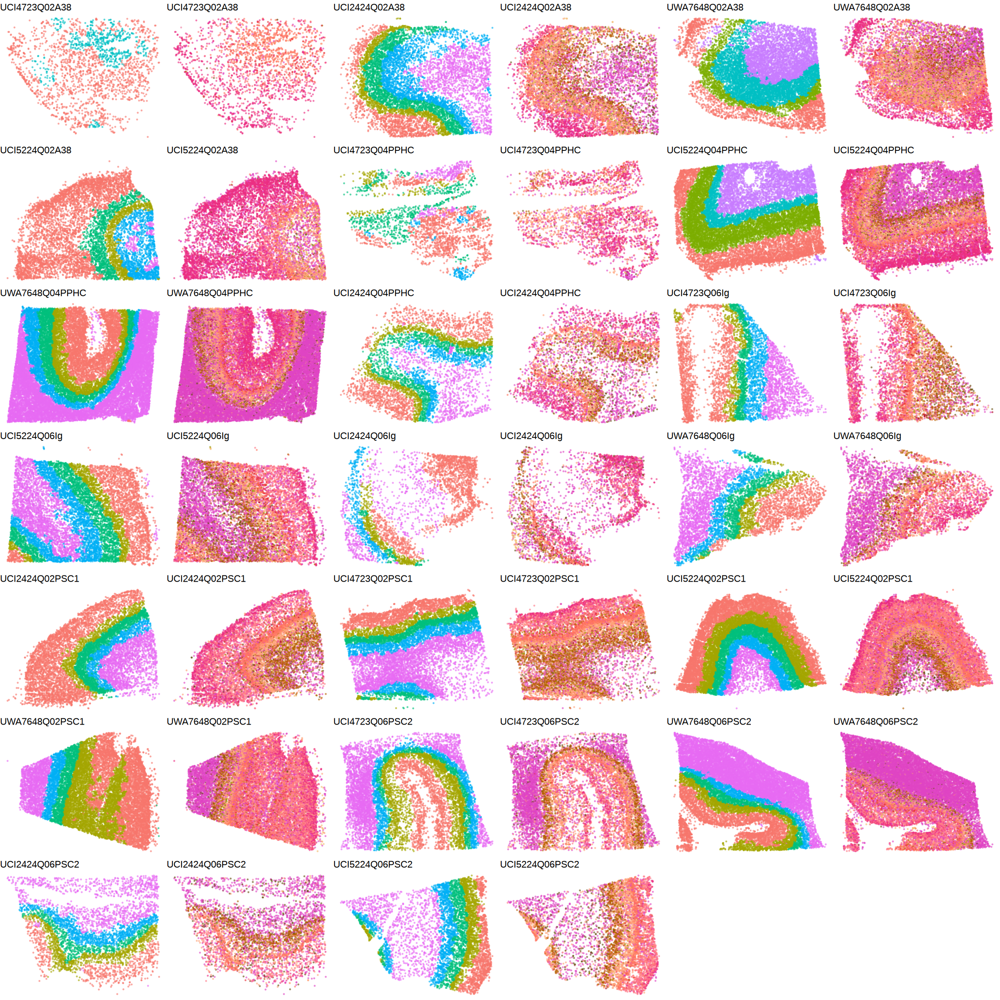

In [100]:
plist <- list()
for (f in unique(mmg2$region)){
    plist[[paste0("niches_", f)]] <- mmg2@meta.data[,c("center_x", "center_y", paste0("niches_", f), "layer")] %>%
    setNames(c("center_x", "center_y", "niches", "layer")) %>%
    filter(!is.na(niches)) %>%
    ggplot(aes(x = center_x, y = center_y, color = layer)) + 
    geom_point(size = 0.3, alpha = 0.5) +
    theme_void() + ggtitle(f)  + NoLegend()
    
    plist[[f]] <- mmg2@meta.data %>% 
    filter(region == f, X_CELLTYPE_CCA != "Low quality") %>%
    ggplot(aes(x = center_x, y = center_y, color = X_CELLTYPE_CCA)) + 
    geom_point(size = 0.3, alpha = 0.5) + 
    theme_void() + ggtitle(f) + 
    scale_color_manual(values = ccol2) + NoLegend()
}

options(repr.plot.width = 20, repr.plot.height = 20)
cowplot::plot_grid(plotlist = plist, ncol = 6)

In [102]:
saveRDS(mmg2, "quan_cortex_annotated.11.20.2025.ITonly.niches.rds")

### Use existing layer annotation as anchors for assigning all MERFISH layer information

In [ ]:
### 1. select cells with high quality laminar structures as anchors
### 2. propagate query cells to the anchors

In [101]:
mmg$layer <- NA
mmg@meta.data[colnames(mmg2),]$layer <- mmg2$layer
mmg <- propagate_layer_labels_weighted(mmg, label_col = "layer", coord_cols = c("center_x", "center_y"), image_col = "region", 
                                         k = 30, weighted = T,
                                         layer_order = c("L2", "L2/3", "L4", "L5", "L56", "L6", "White_matter"))

Processing 20 images...



In [56]:
min_max_norm <- function(x) {
    (x - min(x, na.rm = TRUE)) / (max(x, na.rm = TRUE) - min(x, na.rm = TRUE))
}

### GABA + NonN
rlist <- list()
for (f in goodfov){
    mtx <- mmg@meta.data %>% filter(region == f) %>%
    filter(is.na(layer)) %>%
    filter(!(X_CELLTYPE_CCA %in% c("low quality", "Low quality"))) %>%
    filter(prediction_score >= 0.6) %>%
    select(X_CELLTYPE_CCA, propagated_layer) %>%
    table
    
    rlist[[f]] <- apply(mtx, MARGIN = 1, min_max_norm) %>% as.data.frame %>%
    tibble::rownames_to_column("layer") %>% 
    reshape2::melt() %>% mutate(region = f)
}

rlist <- do.call(rbind, rlist)

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables



In [57]:
### Glut
rlist2 <- list()
for (f in goodfov){
    mtx <- mmg@meta.data %>% filter(region == f) %>%
    filter(!is.na(layer)) %>%
    filter(!(X_CELLTYPE_CCA %in% c("low quality", "Low quality"))) %>%
    select(X_CELLTYPE_CCA, layer) %>%
    table
    
    rlist2[[f]] <- apply(mtx, MARGIN = 1, min_max_norm) %>% as.data.frame %>%
    tibble::rownames_to_column("layer") %>% 
    reshape2::melt() %>% mutate(region = f)
}

rlist2 <- do.call(rbind, rlist2)

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables

Using layer as id variables



In [58]:
ctorder <- c('L2IT','L23IT','L34IT','L4IT','L35IT','L45IT','L5IT','L56IT','L56NP','L5ET','L6IT-1','L6IT-2','L6CT','L6B',
             'URL','SST-CHODL','SST','PVALB','PV-CHC','VIP','PAX6','SNCG','LAMP5','LAMP5-LHX6','MSN','CBGA',
             'FBL','AST','ACBGM','MGC','OPC','OGC','ENDO','IMMUNE')

`summarise()` has grouped output by 'layer'. You can override using the `.groups` argument.
Using avg as value column: use value.var to override.



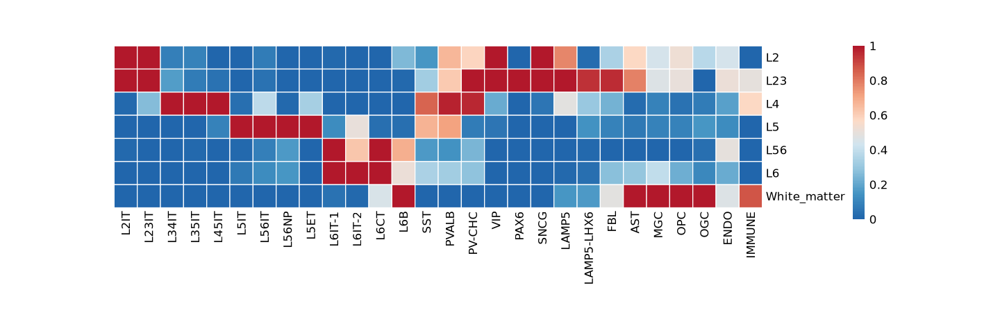

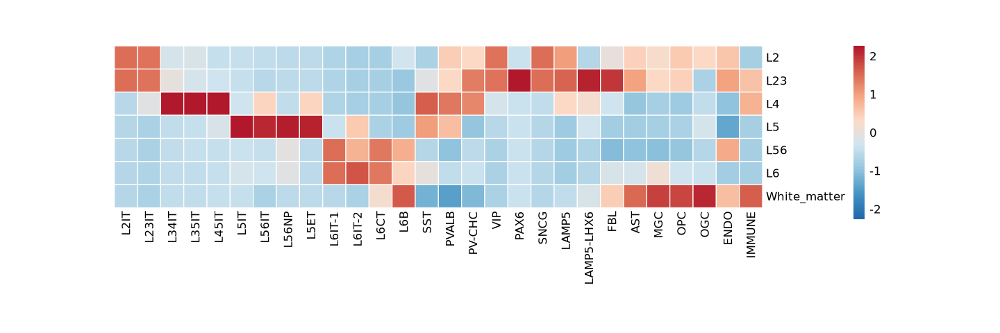

In [59]:
mtx <- rbind(rlist, rlist2) %>% group_by(layer, variable) %>% 
filter(variable != 'SST-CHODL') %>% ### too few
summarise(avg = median(value)) %>%
ungroup %>% reshape2::dcast(layer ~ variable, value.vars = "avg") %>%
tibble::column_to_rownames("layer")

mtx[is.na(mtx)] <- 0

options(repr.plot.width = 12, repr.plot.height = 4)
t1 <- mtx[,intersect(ctorder, colnames(mtx))] %>% 
pheatmap(cluster_col = F, cluster_row = F, scale = "none", 
         cellwidth = 20, cellheight = 20, border_color = "white",
         show_rownames = T, treeheight_row = T, angle_col = 90, 
         color = rev(colorRampPalette(brewer.pal(n = 8, name = "RdBu"))(100)))

t2 <- mtx[,intersect(ctorder, colnames(mtx))] %>% 
pheatmap(cluster_col = F, cluster_row = F, scale = "column", 
         cellwidth = 20, cellheight = 20, border_color = "white",
         show_rownames = T, treeheight_row = T, angle_col = 90, 
         color = rev(colorRampPalette(brewer.pal(n = 8, name = "RdBu"))(100)))

## Spatial prediction for Droplet Paired-Tag cells

In [178]:
### Prediction fov-by-fov and subclass-by-subclass to make sure that projection looks OK
### also output the nearest nn for sanity check
spalist <- nnlist <- qclist <-  list()
for (f in unique(rmatch$region)){
    qregion <- rmatch %>% filter(region == f) %>% select(br_region) %>% unlist %>% as.character
    rmeta <- obj@meta.data %>% filter(orig.ident == "MERFISH", region == f, X_CELLTYPE_CCA != "low quality")
    qmeta <- obj@meta.data %>% filter(orig.ident == "Droplet Paired-Tag", region %in% qregion)
    for (ct in unique(qmeta$subclass_corrected)){
        qcell <- qmeta %>% filter(subclass_corrected == ct) %>% rownames
        ### allow more flexiable matching in reference
        rcell <- rmeta %>% filter(X_CELLTYPE_CCA %in% smatch[smatch$subclass_corrected == ct,]$X_CELLTYPE_CCA) %>% rownames
        if (length(rcell) >= 10){
            qemb <- obj@reductions$integrated.cca@cell.embeddings[qcell, ]
            remb <- obj@reductions$integrated.cca@cell.embeddings[rcell, ]

            ### prepare for QC
            rlabel <- rmeta[rcell, ]$X_CELLTYPE_CCA
            names(rlabel) <- rcell
            qlabel <- qmeta[qcell,]$subclass_corrected
            names(qlabel) <- qcell
            tmp <- run_centroid_prediction(remb, qemb, rmeta[rcell, ], coord_cols = c("center_x", "center_y"), k = 1)
            tmp$fov <- f
            tmp$subclass <- ct
            spalist[[paste0(f, ":", ct)]] <- tmp
            
            ### Output nn list for sanity check
            nnlist[[paste0(f, ":", ct)]] <- getNN(remb, qemb, k = 10, weight_scheme = "fang")
            tmp <- calculate_label_consistency(nnlist[[paste0(f, ":", ct)]], rlabel, qlabel)
            tmp$fov <- f
            tmp$subclass <- ct
            qclist[[paste0(f, ":", ct)]] <- tmp
        }
    }
}

spalist <- do.call(rbind, spalist) 
qclist <- do.call(rbind, qclist)

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 10 nearest neighbors...

2. Calculating fang weights...

2. Finding 1 nearest neighbors...

3. Calculating centroids...

1. Finding 1

In [200]:
write.csv(spalist, "MiniAtlas_spatial_mapping_cca_quan_cortex_annotated.11.20.2025.csv", 
          row.names = T, col.names = T, quote = F)
write.csv(qclist, "MiniAtlas_spatial_mapping_cca_score_quan_cortex_annotated.11.20.2025.csv", 
          row.names = T, col.names = T, quote = F)

Warning message in write.csv(spalist, "MiniAtlas_spatial_mapping_cca_quan_cortex_annotated.11.20.2025.csv", :
“attempt to set 'col.names' ignored”
Warning message in write.csv(qclist, "MiniAtlas_spatial_mapping_cca_score_quan_cortex_annotated.11.20.2025.csv", :
“attempt to set 'col.names' ignored”


## Filter prediction results based on weight and neighbor

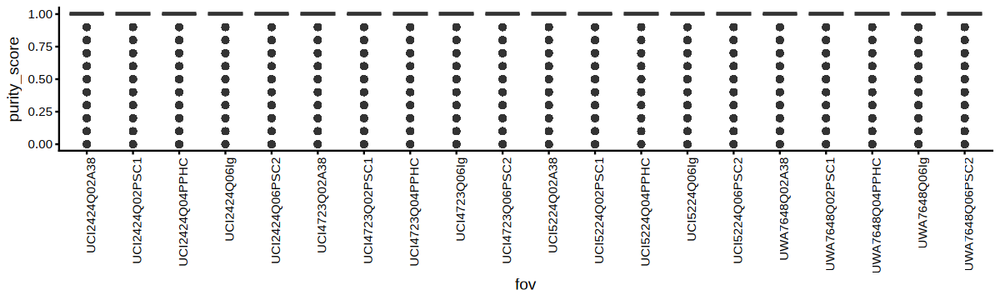

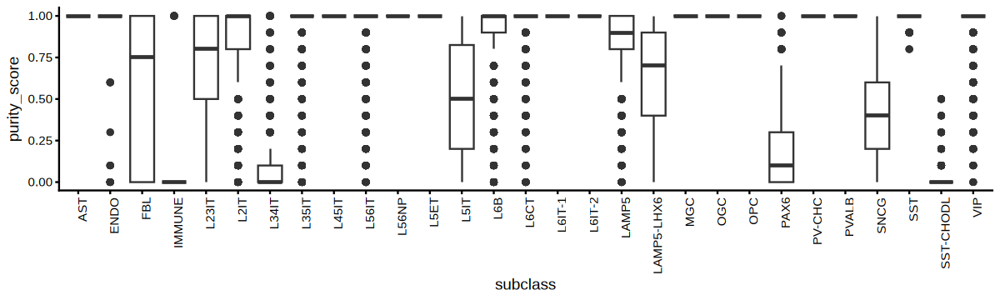

In [187]:
options(repr.plot.width = 10, repr.plot.height = 3)
qclist %>%
ggplot(aes(x = fov, y = purity_score)) + 
geom_boxplot() + 
theme_classic() + 
theme(axis.text.x = element_text(angle = 90, hjust = 1)) + 
NoLegend() 

qclist %>%
ggplot(aes(x = subclass, y = purity_score)) + 
geom_boxplot() + 
theme_classic() + 
theme(axis.text.x = element_text(angle = 90, hjust = 1)) + 
NoLegend() 

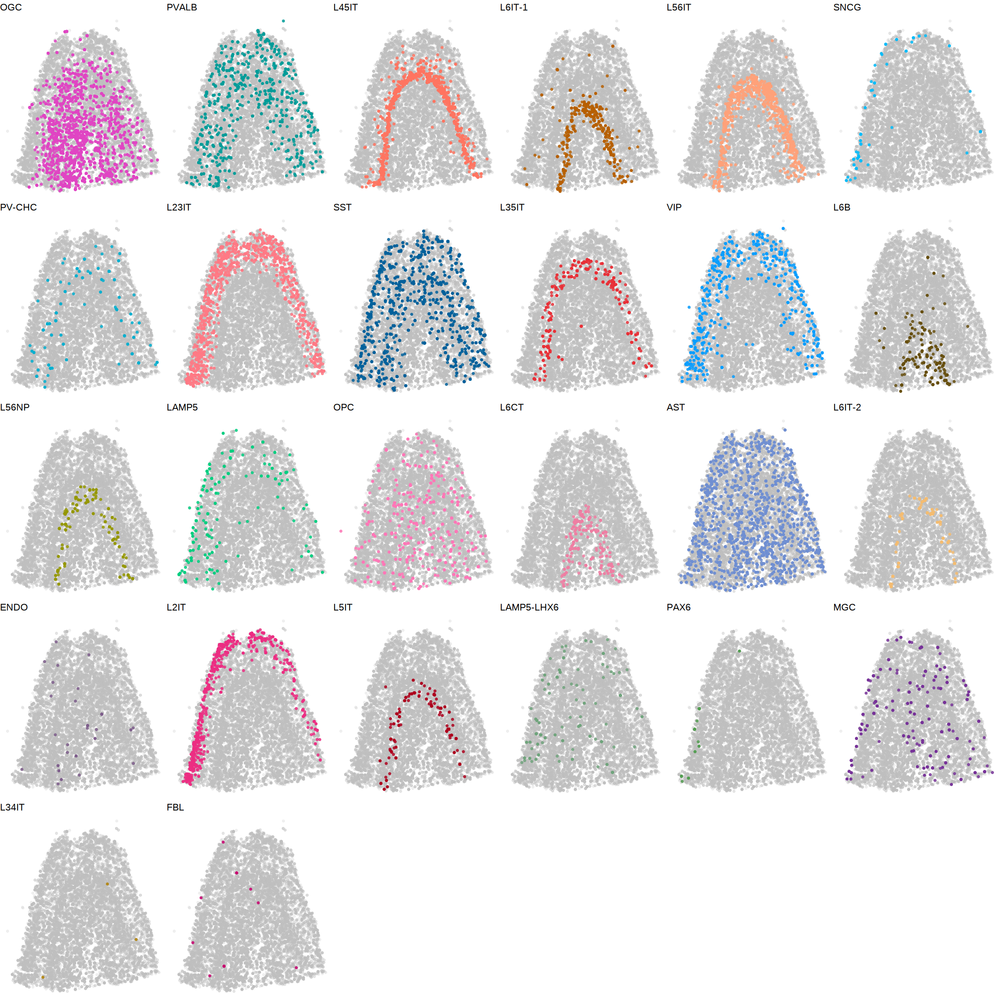

In [28]:
### Query
f <- "UCI5224Q02PSC1"
qcell <- qclist %>% filter(fov == f) %>% filter(purity_score >= 0.5) %>% select(cell_id) %>% unlist %>% as.character 
tmp <- spalist %>% filter(fov == f) %>% filter(cell_id %in% qcell)
# qmeta <- obj@meta.data %>% filter(orig.ident == "Droplet Paired-Tag")
tmp <- merge(tmp, qmeta, by.x = "cell_id", by.y = 0)

plist <- list()
for (ct in unique(tmp$subclass_corrected)){
    plist[[ct]] <- tmp %>%
    ggplot(aes(x = pred_center_x, y = pred_center_y)) + 
    geom_point(size = 1, color = "grey", alpha = 0.2) + 
    geom_point(data = tmp[tmp$subclass_corrected == ct,], 
               aes(x = pred_center_x, y = pred_center_y, color = subclass_corrected), 
               size = 1, alpha = 0.8) + 
    theme_void() + ggtitle(ct) + 
    scale_color_manual(values = ccol2) + NoLegend()
}

options(repr.plot.width = 20, repr.plot.height = 20)
cowplot::plot_grid(plotlist = plist, ncol = 6)

In [43]:
### Reference
rmeta <- obj@meta.data %>% filter(orig.ident == "MERFISH", region == f)

plist2 <- list()
for (ct in intersect(corder, unique(rmeta$X_CELLTYPE_CCA))){
    plist2[[ct]] <- rmeta %>%
    ggplot(aes(x = center_x, y = center_y)) + 
    geom_point(size = 1, color = "grey", alpha = 0.2) + 
    geom_point(data = rmeta[rmeta$X_CELLTYPE_CCA == ct,], 
               aes(x = center_x, y = center_y, color = X_CELLTYPE_CCA), 
               size = 1, alpha = 0.8) + 
    theme_void() + ggtitle(ct) + 
    scale_color_manual(values = ccol2) + NoLegend()
}

options(repr.plot.width = 20, repr.plot.height = 20)
fig1 <- cowplot::plot_grid(plotlist = plist2, ncol = 6)

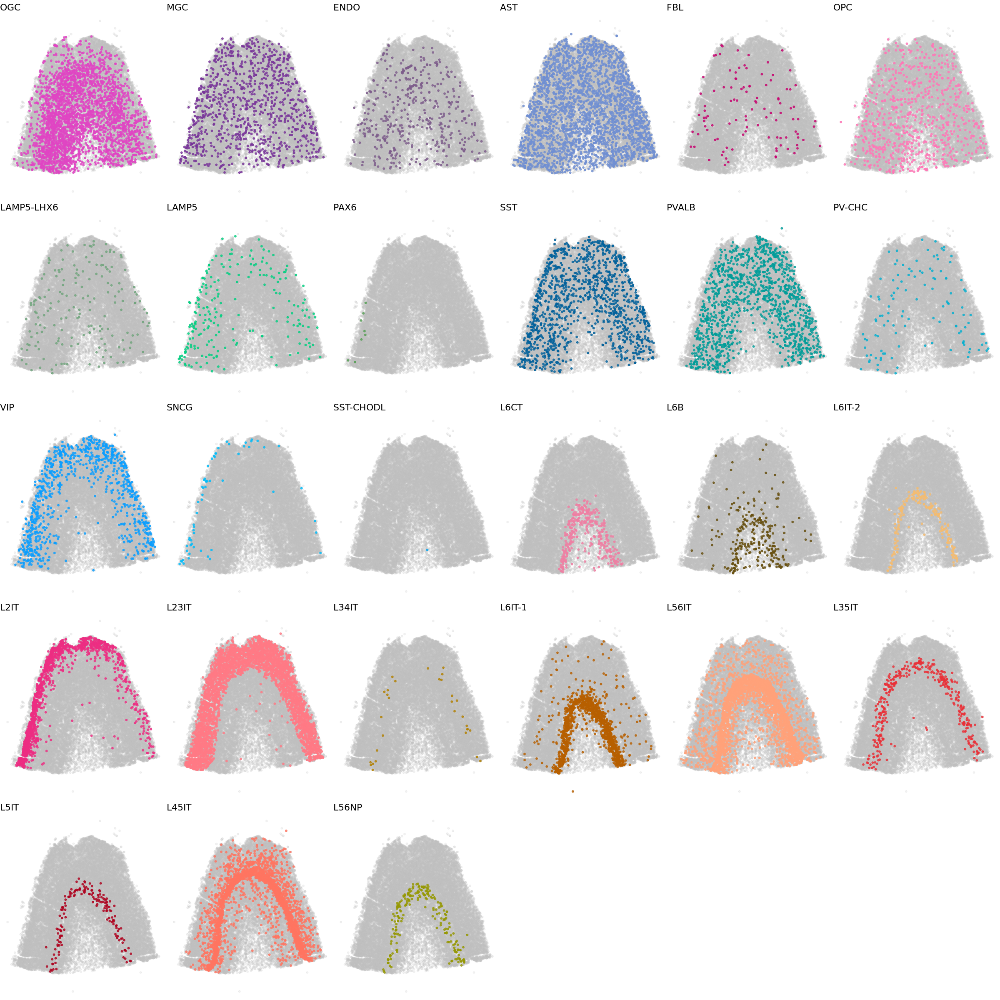

In [44]:
fig1

## Spatial epigenetic features

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



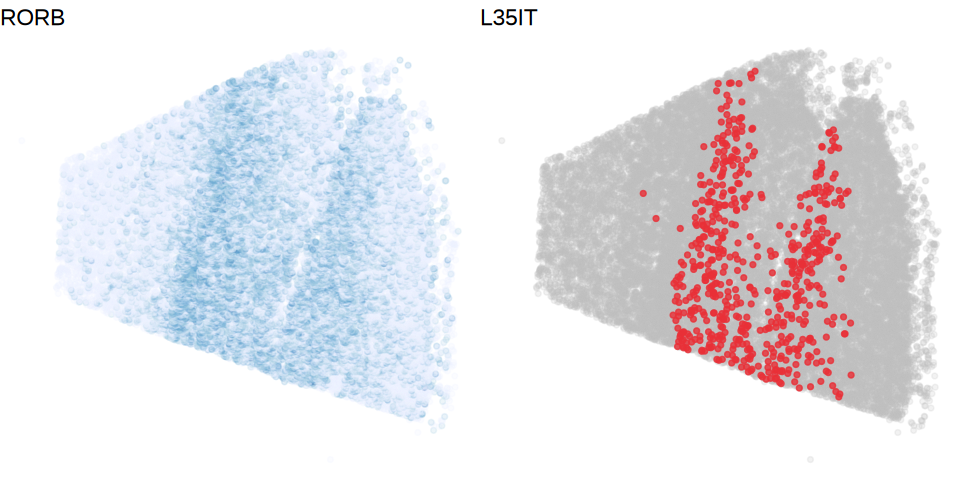

In [222]:
rmeta <- obj@meta.data %>% filter(orig.ident == "MERFISH", region == f)
t1 <- FeaturePlot(obj, "RORB")
t1 <- merge(t1$data, rmeta, by = 0) %>%
ggplot(aes(x = center_x, y = center_y, color = RORB)) + 
geom_point(size = 1, alpha = 0.2) + 
theme_void() + ggtitle("RORB") + 
scale_color_distiller(direction = 1) + NoLegend()

t2 <- rmeta %>%
ggplot(aes(x = center_x, y = center_y)) + 
geom_point(size = 1, color = "grey", alpha = 0.2) + 
geom_point(data = rmeta[rmeta$X_CELLTYPE_CCA == "L35IT",], 
           aes(x = center_x, y = center_y, color = X_CELLTYPE_CCA), 
           size = 1, alpha = 0.8) + 
theme_void() + ggtitle("L35IT") + 
scale_color_manual(values = ccol2) + NoLegend()

options(repr.plot.width = 8, repr.plot.height = 4)
cowplot::plot_grid(t1, t2, ncol = 2)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



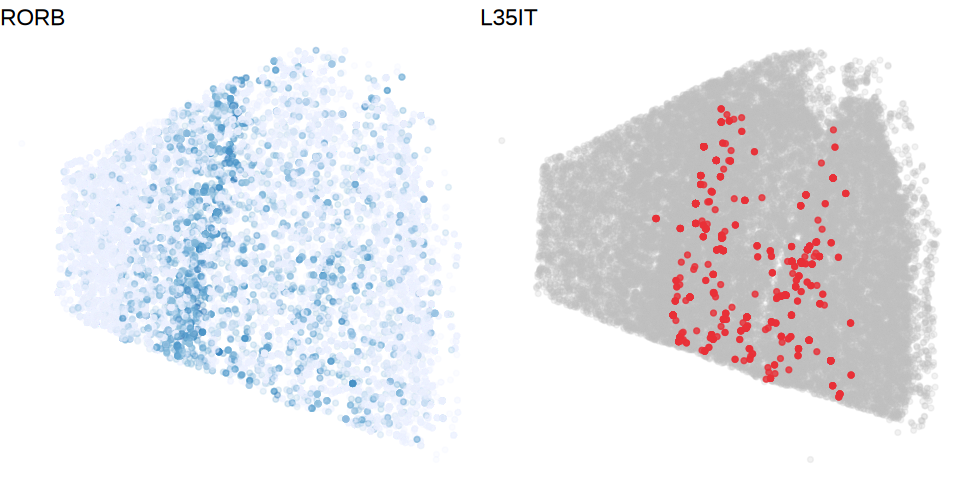

In [223]:
### How about MERFISH looks like?
t1 <- FeaturePlot(obj, "RORB")
t1 <- merge(t1$data, tmp, by.x = 0, by.y = "cell_id") %>%
ggplot(aes(x = pred_center_x, y = pred_center_y, color = RORB)) + 
geom_point(size = 1, alpha = 0.2) + 
theme_void() + ggtitle("RORB") + 
scale_color_distiller(direction = 1) + NoLegend()

t2 <- rmeta %>%
ggplot(aes(x = center_x, y = center_y)) + 
geom_point(size = 1, color = "grey", alpha = 0.2) + 
geom_point(data = tmp[tmp$subclass_corrected == "L35IT",], 
           aes(x = pred_center_x, y = pred_center_y, color = subclass_corrected), 
           size = 1, alpha = 0.8) + 
theme_void() + ggtitle("L35IT") + 
scale_color_manual(values = ccol2) + NoLegend()

options(repr.plot.width = 8, repr.plot.height = 4)
cowplot::plot_grid(t1, t2, ncol = 2)

In [10]:
# qgene <- c('CRH','GAL','HES1','GRIA1','CNR1','ATP1B2','SCN1B','TRPC3','HTR1B')
qgene <- c("GRIK3", "LRRC4", "CIGSF11", "LRRN1", "NECTIN3", "SLITRK2", "CDH7", "SDK1", "ROBO2", "GRM7", "TPBG", "GRIN3A", "ARHGAP12")
qfeature <- intersect(qgene, rownames(mmg))
qfeature

[1] "GRIK3" "CDH7"  "ROBO2"

## Use diffusion map to predict the pseudolayer

In [27]:
mmg <- readRDS("quan_cortex_annotated.11.20.2025.rds")
obj <- readRDS("quan_cortex_annotated.11.20.2025_MiniAtlas_integration.rds")

In [10]:
### SST as example
qct <- "SST"
vcell1 <- obj@meta.data %>% filter(orig.ident == "Droplet Paired-Tag", subclass_corrected %in% qct) %>% rownames
vcell2 <- obj@meta.data %>% filter(orig.ident == "MERFISH", X_CELLTYPE_CCA %in% qct, !is.na(X_CELLTYPE_CCA)) %>% rownames

In [38]:
### diffusion map on joint embedding using in house method to best recaptiluate scENVI
emb <- obj@reductions$integrated.cca@cell.embeddings[c(vcell1, vcell2), ]
dm <- run_diffusion_maps_R(emb, n_components = 20, knn = 30, alpha = 0.5)
names(dm)

[1] "eigenvalues"          "diffusion_components"

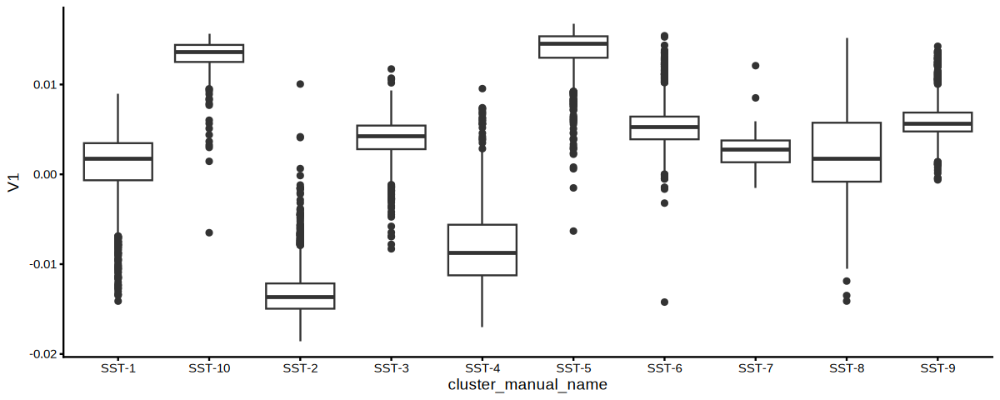

In [42]:
### determine direction2
options(repr.plot.width = 10, repr.plot.height = 4)
merge(obj@meta.data[vcell1,], qmtx, by = 0) %>% 
ggplot(aes(x = cluster_manual_name, y = V1)) +
geom_boxplot() +
theme_classic()

### quite comparable to destiny